<center><img src="https://github.com/hse-ds/iad-applied-ds/blob/master/2021/hw/hw1/img/logo_hse.png?raw=1" width="1000"></center>

<h1><center>Прикладные задачи анализа данных</center></h1>
<h2><center>Домашнее задание 3: прогнозирование временных рядов</center></h2>

**Мягкий дедлайн:** 23:59MSK 19.05.2024

**Жесткий дедлайн:** 23:59MSK 26.05.2024

In [ ]:
!pip install -r requirements.txt -q

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 422.2/422.2 kB 5.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 750.6/750.6 MB 1.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 354.1/354.1 kB 37.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 139.3/139.3 kB 19.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 12.3/12.3 MB 101.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 98.2/98.2 MB 8.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 116.3/116.3 kB 16.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 57.2/57.2 kB 6.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 79.5/79.5 kB 11.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 12.1/12.1 MB 100.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.1/2.1 MB 94.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.2/1.2 MB 69.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━

In [ ]:
import warnings
import gdown
import pandas as pd
import numpy as np
from copy import deepcopy

warnings.filterwarnings("ignore")

В данной задаче мы будем решать одну из актуальных практических задач, с которыми, в том числе, сталкиваются разработчики ETNA - прогнозирование объема необходимой наличности в банкоматах. Пожалуй, ни для кого не секрет, что отсутствие необходимой суммы в банкомате не делает клиента банка счастливее. В то же время, избыток заправленной в банкомат наличности приводит к упущенной выгоде - ведь, в конечном счете, эти деньги могли быть размещены в качестве краткосрочного депозита на межбанковском рынке. Для кредитной организации с обширной сетью банкоматов даже незначительное улучшение качества предсказания способно внести значительный вклад в прибыльность этой ветки бизнеса.

В качестве инструмента воспользуемся библиотекой ETNA, документацию можно прочитать [тут](https://docs.etna.ai/stable/), и [чат](https://t.me/etna_support) комьюнити.

Мы будем использовать дневные данные реальных банкоматов для чего возьмем мультисегментный датасет.

In [ ]:
url = 'https://gist.githubusercontent.com/Polzovat123/4d6d5e544e93429c2d3db29196e9c918/raw/24b27e60f587128d71678e267f51cd48472c6a84/atms_daily_cash.csv'
output = 'atms_daily_cash.csv'
gdown.download(url=url, output=output, quiet=False, fuzzy=True)

df = pd.read_csv('atms_daily_cash.csv', index_col=False)

Downloading...
From: https://gist.githubusercontent.com/Polzovat123/4d6d5e544e93429c2d3db29196e9c918/raw/24b27e60f587128d71678e267f51cd48472c6a84/atms_daily_cash.csv
To: /content/atms_daily_cash.csv
100%|██████████| 258k/258k [00:00<00:00, 12.2MB/s]


Полученные данные были просуммированы по банкоматам и дням эксплуатации, после чего залиты в gist, откуда мы и берем их.

Взглянем на то, что представляют из себя данные после этих действий:

In [ ]:
df.head()

,datetime,atm_id,operation_value
0,2017-08-16,74,2.059266
1,2017-08-17,74,1.029633
2,2017-08-18,74,0.686422
3,2017-08-19,74,33.301267
4,2017-08-20,74,-12.237921


In [ ]:
df.atm_id.unique()

array([ 74,  85,  86,  87,  88,  90,  91,  93,  94,  96,  97,  98,  99,
       100, 101, 102, 103, 104, 105, 106])

### Задание 1. EDA (1.75 балл)

Проведите разведывательный анализ данных с помощью `ETNA`- постройте графики, на которых можно судить о наличии тренда, сезонности и прочих зависимостей. Проанализируйте корреляции. Какие выводы вы можете сделать?

Ссылку на туториал по EDA можно найти [тут](https://docs.etna.ai/stable/tutorials/103-EDA.html#EDA).

In [ ]:
from etna.datasets import TSDataset

In [ ]:
df = df.rename(columns={'datetime': 'timestamp', 'operation_value': 'target', 'atm_id': 'segment'})
df.timestamp = pd.to_datetime(df.timestamp)
df = TSDataset.to_dataset(df)
df.head()

segment,100,101,102,103,104,105,106,74,85,86,87,88,90,91,93,94,96,97,98,99
feature,target,target,target,target,target,target,target,target,target,target,target,target,target,target,target,target,target,target,target,target
timestamp,,,,,,,,,,,,,,,,,,,,
2017-06-09,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.617780,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2017-06-10,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.441486,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2017-06-11,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-0.235345,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2017-06-12,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-13.532317,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2017-06-13,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,7.398647,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
df.shape

(479, 20)

In [ ]:
ts = TSDataset(df, freq='D')
ts.describe()

,start_timestamp,end_timestamp,length,num_missing,num_segments,num_exogs,num_regressors,num_known_future,freq
segments,,,,,,,,,
100,2017-08-11,2018-09-30,416,3,20,0,0,0,D
101,2017-08-11,2018-09-30,416,3,20,0,0,0,D
102,2017-08-02,2018-09-30,425,3,20,0,0,0,D
103,2017-08-08,2018-09-30,419,3,20,0,0,0,D
104,2017-08-07,2018-09-30,420,3,20,0,0,0,D
105,2017-07-28,2018-09-30,430,3,20,0,0,0,D
106,2017-08-09,2018-09-30,418,3,20,0,0,0,D
74,2017-08-16,2018-09-30,411,3,20,0,0,0,D
85,2017-08-03,2018-09-30,424,3,20,0,0,0,D


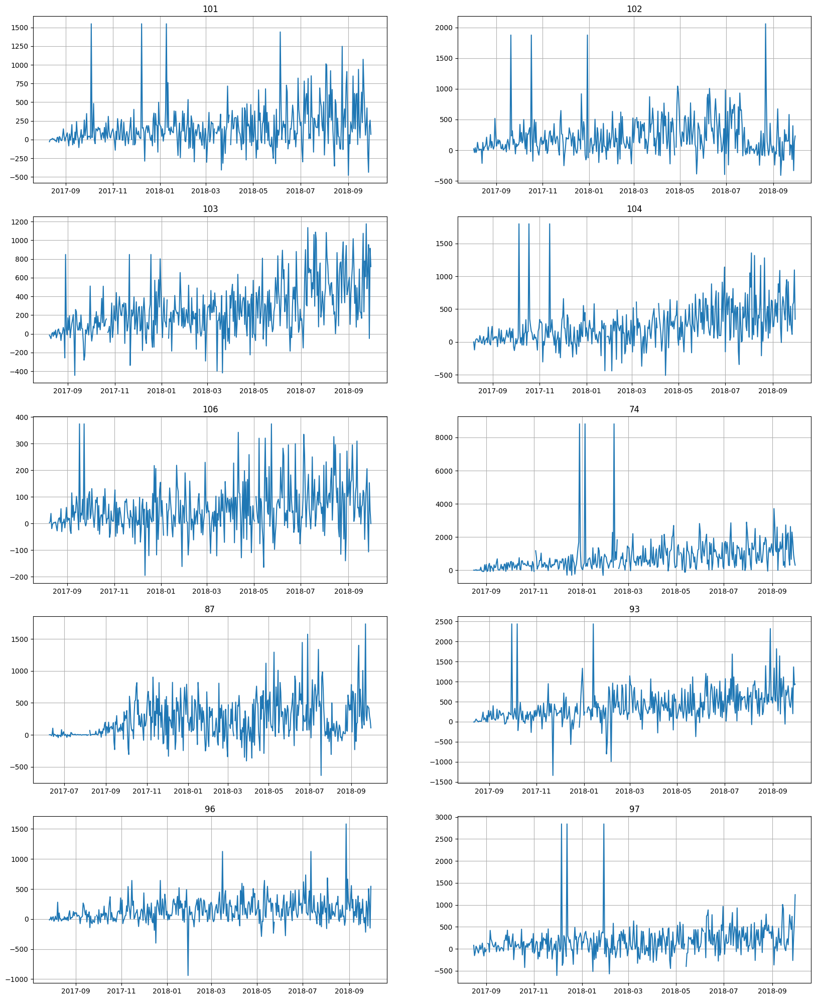

In [ ]:
ts.plot()

In [ ]:
from etna.analysis import acf_plot
from etna.analysis import cross_corr_plot
from etna.analysis import distribution_plot
from etna.analysis import plot_correlation_matrix

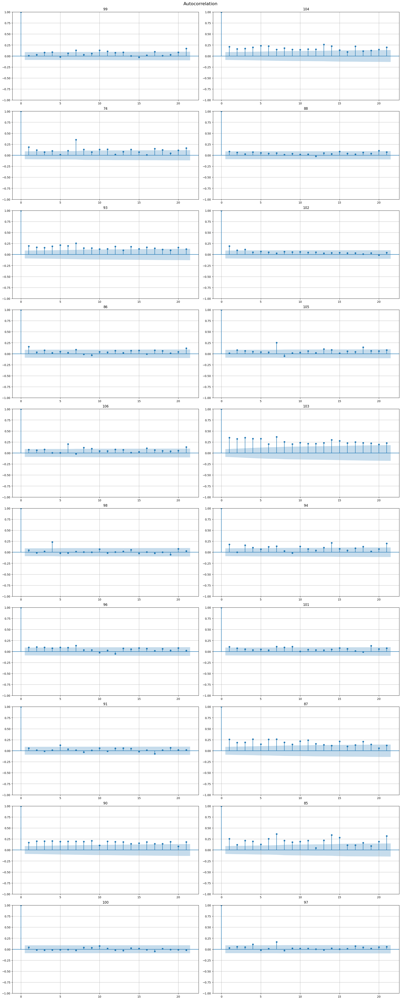

In [ ]:
acf_plot(ts, n_segments=ts.size()[1])

In [ ]:
# возьмем три сегмента для визуализации
segments_to_plot = ['100', '102', '104']

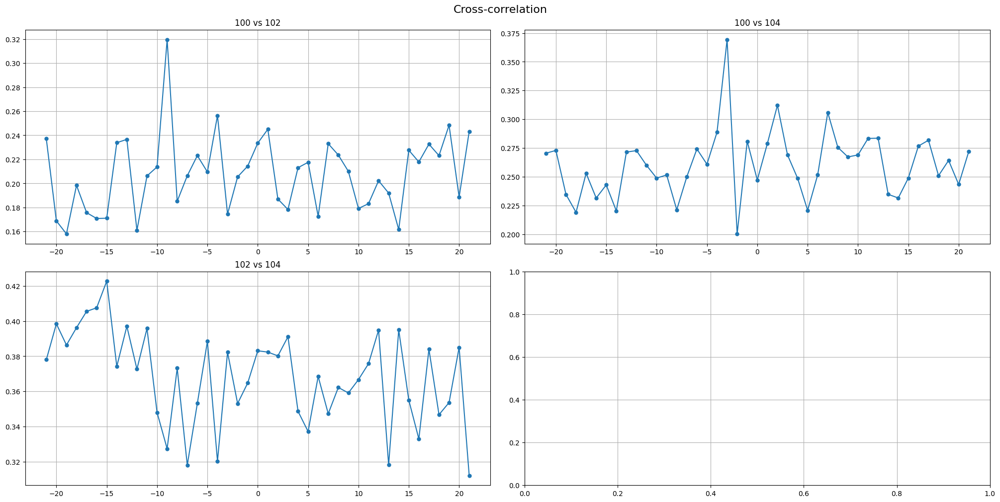

In [ ]:
cross_corr_plot(ts, segments=segments_to_plot)

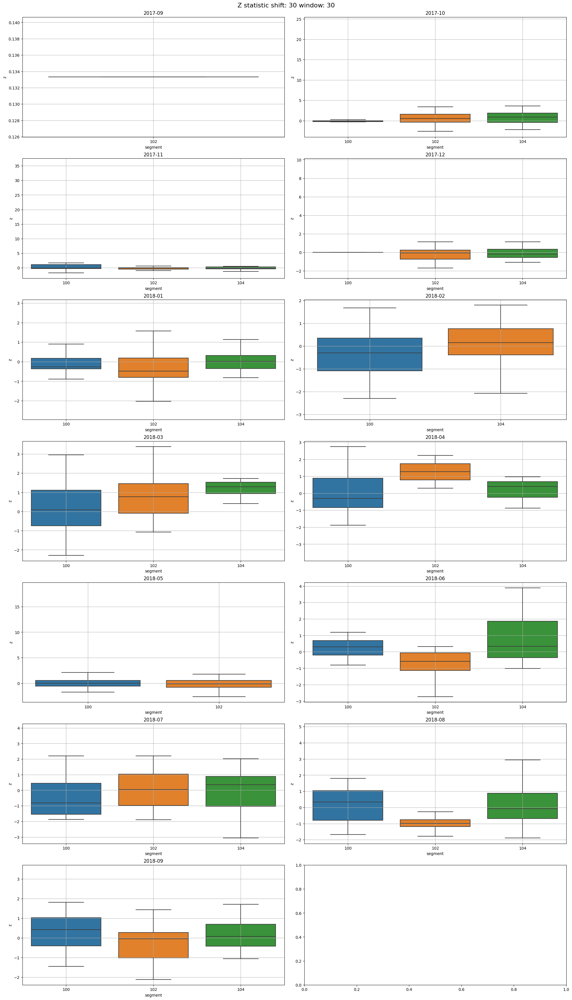

In [ ]:
distribution_plot(ts, segments=segments_to_plot)

In [ ]:
from etna.transforms import LagTransform

In [ ]:
lags = LagTransform(in_column='target', lags=[1, 7], out_column='lag')
ts.fit_transform([lags])

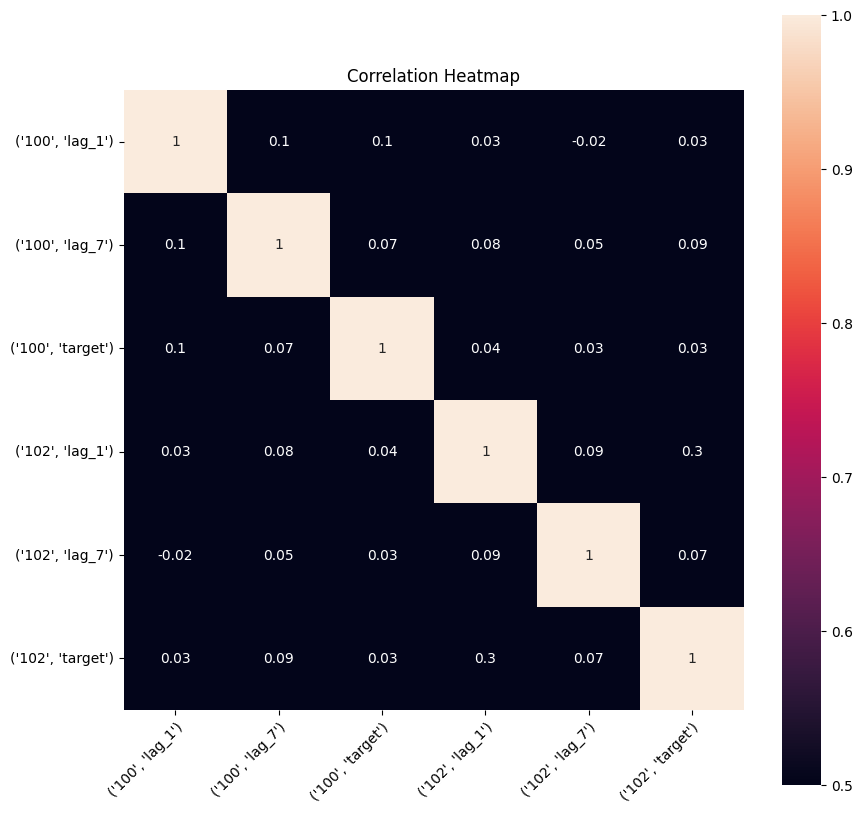

In [ ]:
plot_correlation_matrix(ts, segments=segments_to_plot[:2], method='spearman', vmin=0.5, vmax=1)

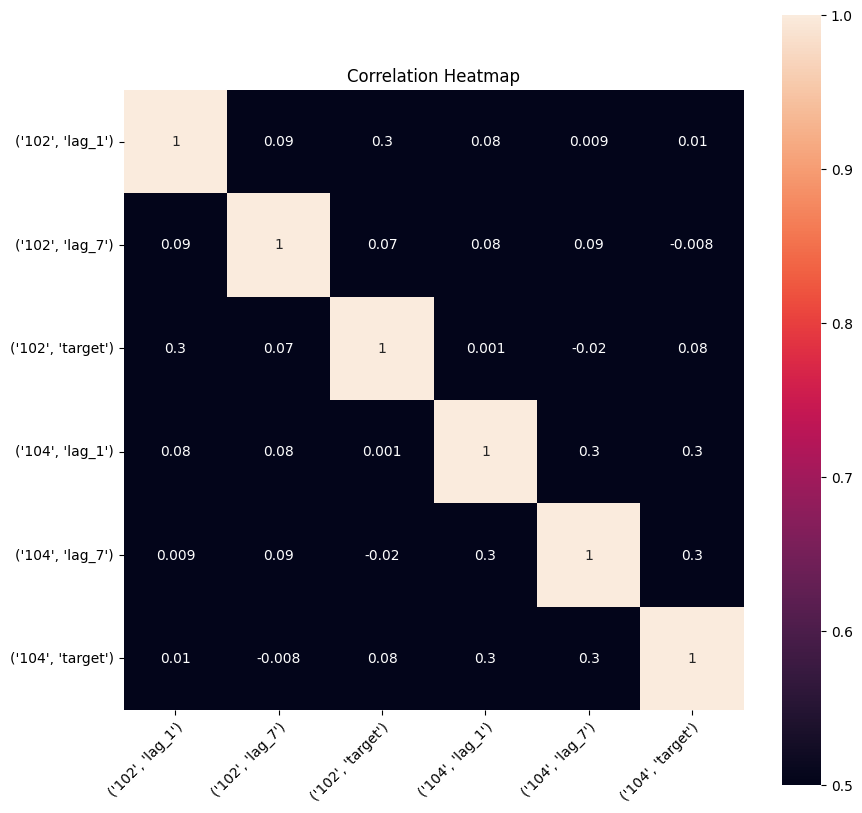

In [ ]:
plot_correlation_matrix(ts, segments=segments_to_plot[1:], method='spearman', vmin=0.5, vmax=1)

In [ ]:
from etna.analysis import plot_trend
from etna.transforms import LinearTrendTransform

trend = LinearTrendTransform(in_column='target')
ts.fit_transform([lags])

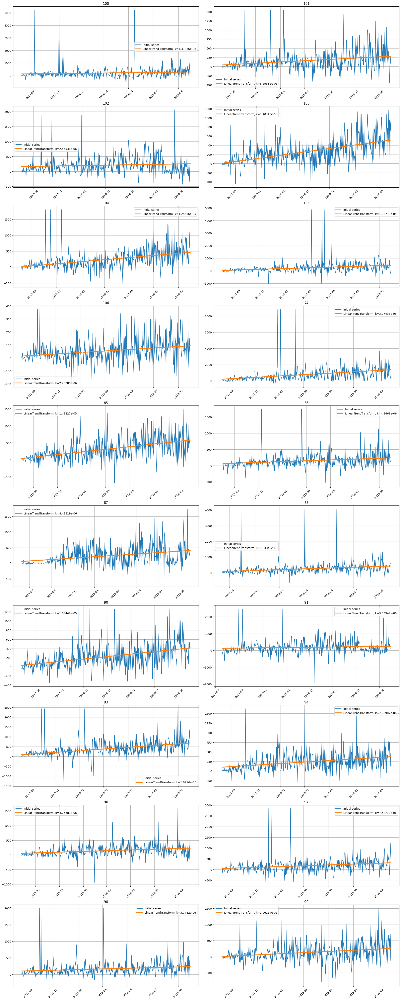

In [ ]:
plot_trend(ts, trend_transform=trend)

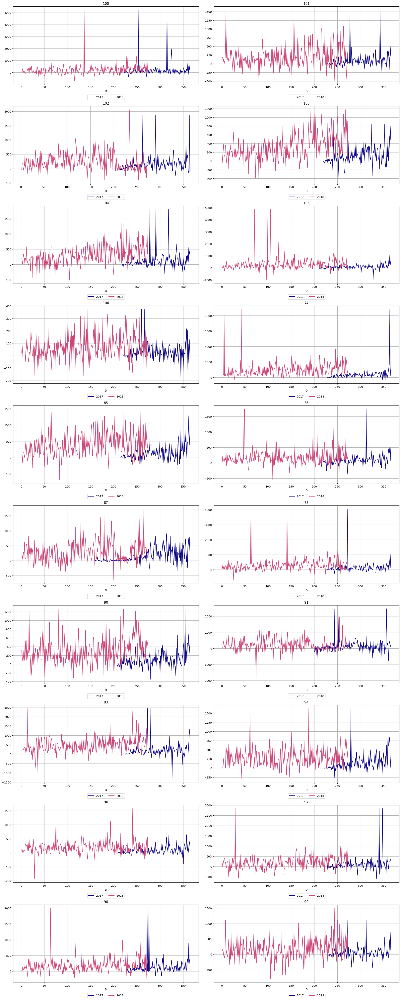

In [ ]:
from etna.analysis import seasonal_plot

seasonal_plot(ts, cycle='year')

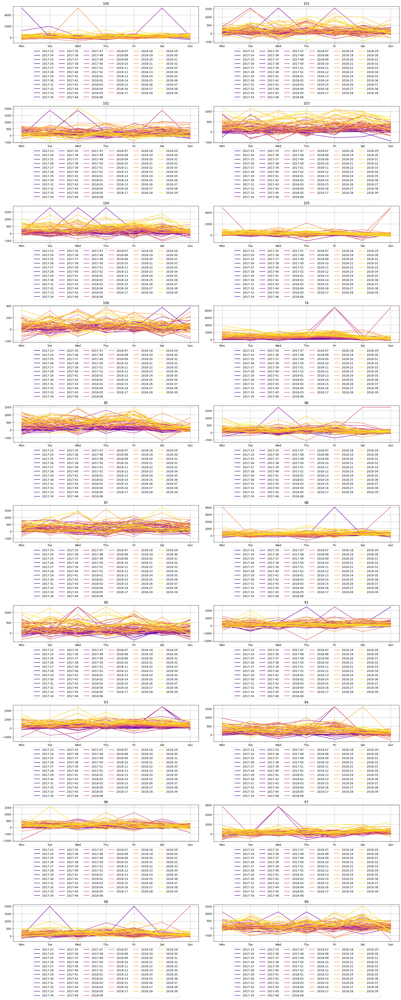

In [ ]:
seasonal_plot(ts, cycle='week')

видим, что лаги не сильно коррелируются с таргетом, между сегментами нет зависимостей, а также в данных наблюдается тренд. о сезонности тяжело говорить в силу нагруженности получившихся графиков. возможно, для некоторых сегментов можно отметить наибольшие значение в определенные дни недели/части месяца

### Задание 2. Работа с пропущенными значениями и выбросами (1 балл)

Проанализируйте, есть ли в данных пропущенные значения, и подберите оптимальный метод их заполнения средствами ETNA. Какие методы вы выберете и почему? Совет: возможно, лучше сохранить заполненные данные в отдельный объект, поскольку некоторые модели заполняют пропуски встроенными методами, и подача на вход "сырых" данных (на языке временных рядов это данные с нерегулярными интервалами) может принести лучший результат.

Импорты всех необходимых компонент произведите самостоятельно.

In [ ]:
# сохраним оригинальный дф в отдельный объект
original_df = deepcopy(df)

In [ ]:
ts.head()

segment,100,101,102,103,104,105,106,74,85,86,87,88,90,91,93,94,96,97,98,99
feature,target,target,target,target,target,target,target,target,target,target,target,target,target,target,target,target,target,target,target,target
timestamp,,,,,,,,,,,,,,,,,,,,
2017-06-09,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.617780,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2017-06-10,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.441486,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2017-06-11,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-0.235345,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2017-06-12,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-13.532317,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2017-06-13,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,7.398647,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
from etna.transforms import TimeSeriesImputerTransform

In [ ]:
# заполним пустые значения средним значением за 14 лагов
nan_imputer = TimeSeriesImputerTransform(
    in_column='target', strategy='running_mean', window=14
)
ts.fit_transform([nan_imputer])

In [ ]:
ts.describe()

,start_timestamp,end_timestamp,length,num_missing,num_segments,num_exogs,num_regressors,num_known_future,freq
segments,,,,,,,,,
100,2017-08-11,2018-09-30,416,0,20,0,0,0,D
101,2017-08-11,2018-09-30,416,0,20,0,0,0,D
102,2017-08-02,2018-09-30,425,0,20,0,0,0,D
103,2017-08-08,2018-09-30,419,0,20,0,0,0,D
104,2017-08-07,2018-09-30,420,0,20,0,0,0,D
105,2017-07-28,2018-09-30,430,0,20,0,0,0,D
106,2017-08-09,2018-09-30,418,0,20,0,0,0,D
74,2017-08-16,2018-09-30,411,0,20,0,0,0,D
85,2017-08-03,2018-09-30,424,0,20,0,0,0,D


Проверьте ряды на наличие выбросов, и очистите их соответствующим образом. Обоснуйте выбор.

In [ ]:
from etna.analysis.outliers import (get_anomalies_density, get_anomalies_hist,
                                    get_anomalies_median,
                                    get_anomalies_prediction_interval)

from etna.analysis import plot_anomalies, plot_anomalies_interactive

In [ ]:
segment = '104'
method = get_anomalies_median
params_bounds = {'window_size': (7, 30, 1), 'alpha': (0.1, 4, 0.25)}

plot_anomalies_interactive(
    ts=ts, segment=segment, method=method, params_bounds=params_bounds
)

interactive(children=(IntSlider(value=7, continuous_update=False, description='window_size', max=30, min=7, st…

In [ ]:
segment = '100'
method = get_anomalies_median
params_bounds = {'window_size': (7, 30, 1), 'alpha': (0.1, 4, 0.25)}

plot_anomalies_interactive(
    ts=ts, segment=segment, method=method, params_bounds=params_bounds
)

interactive(children=(IntSlider(value=7, continuous_update=False, description='window_size', max=30, min=7, st…

In [ ]:
segment = '102'
method = get_anomalies_median
params_bounds = {'window_size': (7, 30, 1), 'alpha': (0.1, 4, 0.25)}

plot_anomalies_interactive(
    ts=ts, segment=segment, method=method, params_bounds=params_bounds
)

interactive(children=(IntSlider(value=7, continuous_update=False, description='window_size', max=30, min=7, st…

In [ ]:
segment = '104'
method = get_anomalies_density
params_bounds = {'window_size': (7, 30, 1), 'n_neighbors': (3, 15, 1)}

plot_anomalies_interactive(
    ts=ts, segment=segment, method=method, params_bounds=params_bounds
)

interactive(children=(IntSlider(value=7, continuous_update=False, description='window_size', max=30, min=7, st…

In [ ]:
segment = '102'
method = get_anomalies_density
params_bounds = {'window_size': (7, 30, 1), 'n_neighbors': (3, 15, 1)}

plot_anomalies_interactive(
    ts=ts, segment=segment, method=method, params_bounds=params_bounds
)

interactive(children=(IntSlider(value=7, continuous_update=False, description='window_size', max=30, min=7, st…

In [ ]:
segment = '100'
method = get_anomalies_density
params_bounds = {'window_size': (7, 30, 1), 'n_neighbors': (3, 15, 1)}

plot_anomalies_interactive(
    ts=ts, segment=segment, method=method, params_bounds=params_bounds
)

interactive(children=(IntSlider(value=7, continuous_update=False, description='window_size', max=30, min=7, st…

In [ ]:
# основываясь на интерактивном графике, выберем лучшие параметры для вычисления выбросов и их дальнейшей замены
best_params = {'window_size': 12, 'alpha': 2.1}

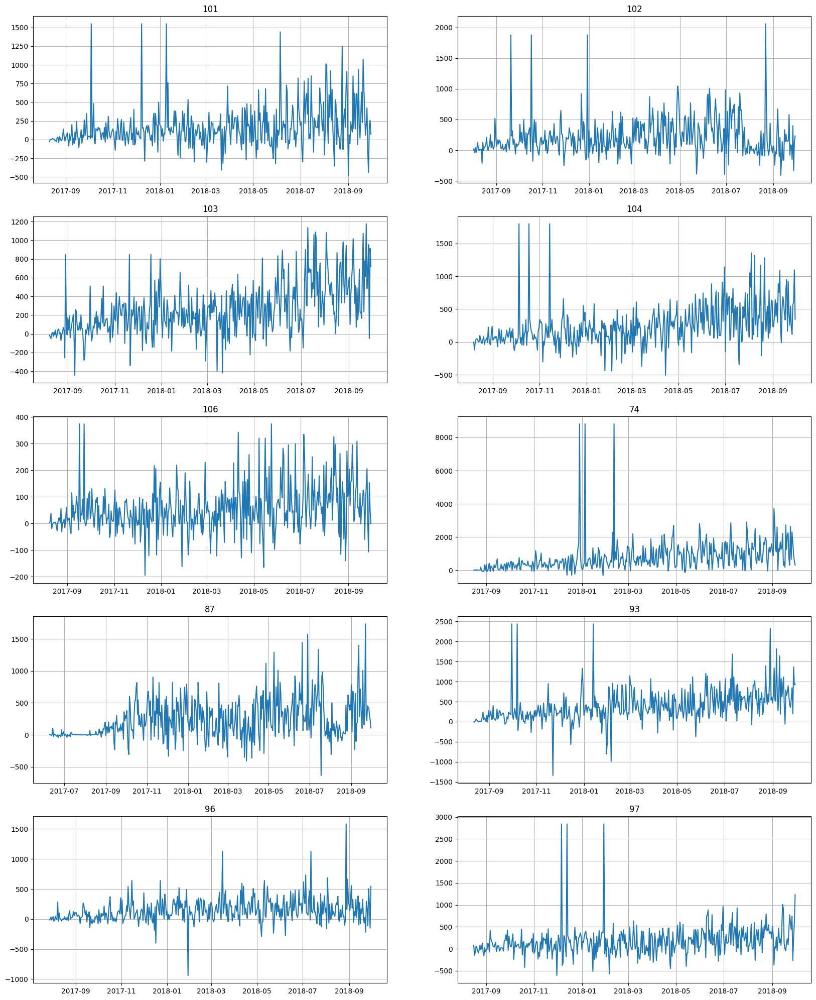

In [ ]:
# визуализация данных до обработки аутлаеров
ts.plot()

In [ ]:
from etna.transforms import MedianOutliersTransform

In [ ]:
outliers_remover = MedianOutliersTransform(in_column='target', **best_params)
nans_imputer = TimeSeriesImputerTransform(
    in_column='target', strategy='running_mean', window=10
)

ts.fit_transform([outliers_remover, nans_imputer])

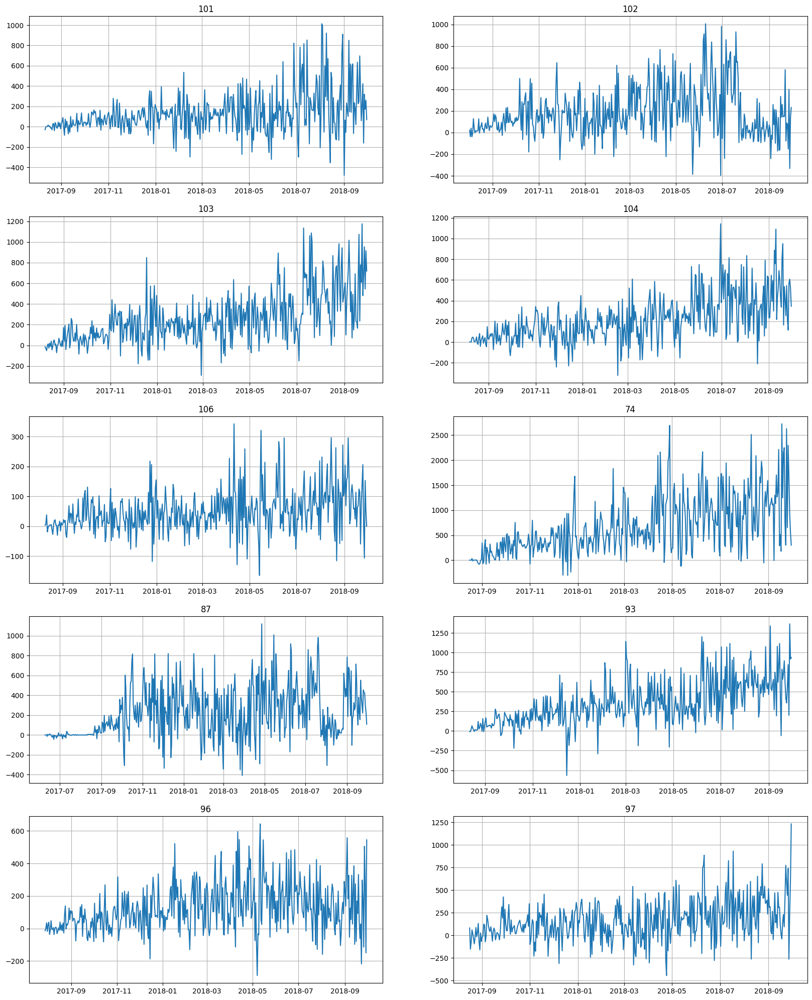

In [ ]:
# визуализация данных после обработки аутлаеров
ts.plot()

### Задание 3. Построение Prophet (1.25 балла)

Постройте прогнозы с помощью Prophet и `etna.Pipeline`, под капотом `etna.Pipeline` обучит `ProphetModel` для каждого сегмента в отдельности. После этого оцените качество по SMAPE на кросс-валидации. В качестве горизонта предсказания возьмите 5 дней - этого же горизонта будем придерживаться и в дальнейшем.

Отрисуйте получившийся прогноз.

In [ ]:
from etna.pipeline import Pipeline
from etna.models import ProphetModel
from etna.metrics import SMAPE, MAE
from etna.analysis import plot_backtest

In [ ]:
HORIZON = 5
model = ProphetModel()
transforms = []

In [ ]:
pipeline = Pipeline(
    model=model,
    transforms=transforms,
    horizon=HORIZON,
)

metrics_df, forecast_df, fold_info_df = pipeline.backtest(
    ts=ts, metrics=[MAE(), SMAPE()], aggregate_metrics=True
)

INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmp8397124y/tc0yf7fl.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmp8397124y/flctc0mr.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=32176', 'data', 'file=/tmp/tmp8397124y/tc0yf7fl.json', 'init=/tmp/tmp8397124y/flctc0mr.json', 'output', 'file=/tmp/tmp8397124y/prophet_modeljsuccsnb/prophet_model-20240526185215.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
18:52:15 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
18:52:15 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
INFO:prophet:Disabling yearly seasonalit

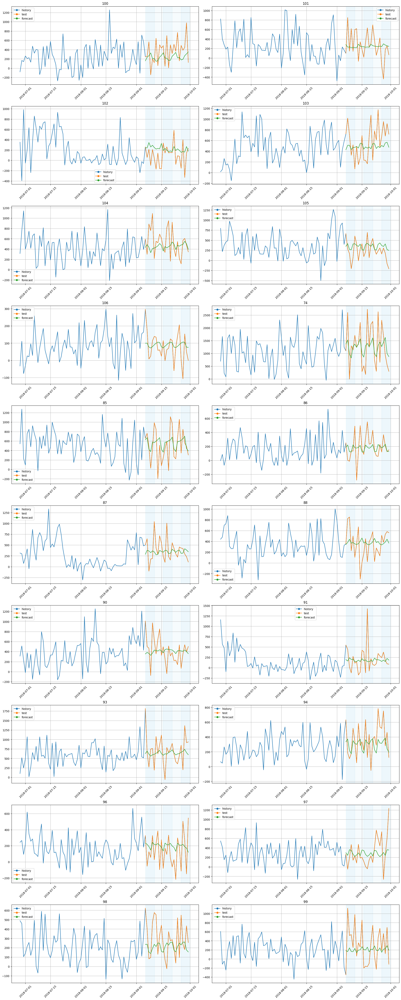

In [ ]:
plot_backtest(forecast_df, ts, history_len=70)

In [ ]:
metrics_df.head()

,segment,MAE,SMAPE
0,100,231.884852,76.494114
1,101,231.042649,81.082262
2,102,189.163436,95.477648
3,103,265.369397,52.211356
4,104,218.650811,44.503348


Исходя из статистики по каждому ряду, какой можно сделать вывод о том, как лучше предсказывать итоговое значение? Посчитайте то же самое исходя из MAE.

### Задание 4. Иерархический временной ряд (2 балла)

Вопрос, поставленный в прошлом задании, тем не менее, естественным образом подводит нас к концепции **иерархического временного ряда** (когда один ряд состоит из других в качестве компонент). Это полезная концепция, которая может встретиться во многих задачах. В этом задании вам предстоит самостоятельно разобраться в деталях ее реализации в ETNA с использованием справочных материалов, предоставляемых библиотекой (как это часто бывает на практике). Они содержатся по следующей ссылке:

https://github.com/etna-team/etna/blob/master/examples/303-hierarchical_pipeline.ipynb

На выходе из первой части задания необходимо получить `TSDataset` с иерархической структурой, а также соответствующий реконсилятор, который позволит собирать искомый ряд из составных компонент. Классы, которые вам понадобятся, импортированы ниже.

In [ ]:
from etna.datasets import HierarchicalStructure
from etna.pipeline import HierarchicalPipeline
from etna.reconciliation import TopDownReconciliator

In [ ]:
hierarchical_structure = HierarchicalStructure(
    level_structure={'total': list(map(str, (74,  85,  86,  87,  88,  90,  91,  93,  94,  96,  97,  98,  99,
       100, 101, 102, 103, 104, 105, 106)))}, level_names=['total', 'atm_id']
    )

hierarchical_structure

HierarchicalStructure(level_structure = {'total': ['74', '85', '86', '87', '88', '90', '91', '93', '94', '96', '97', '98', '99', '100', '101', '102', '103', '104', '105', '106']}, level_names = ['total', 'atm_id'], )

In [ ]:
hierarchical_df = deepcopy(df)

In [ ]:
hierarchical_df.describe()

segment,100,101,102,103,104,105,106,74,85,86,87,88,90,91,93,94,96,97,98,99
feature,target,target,target,target,target,target,target,target,target,target,target,target,target,target,target,target,target,target,target,target
count,413.000000,413.000000,422.000000,416.000000,417.000000,427.000000,415.000000,408.000000,421.000000,423.000000,476.000000,410.000000,428.000000,436.000000,412.000000,414.000000,427.000000,408.000000,407.000000,408.000000
mean,206.852990,160.780309,211.224043,259.002641,239.632873,236.310066,54.820607,785.701946,315.593442,149.763566,230.229024,250.583305,221.532273,184.056115,388.271825,239.121172,143.170209,177.423929,169.715481,130.118485
std,513.339947,277.683036,301.338461,280.860063,311.561920,497.301176,90.481720,958.683509,340.390744,233.092214,310.091564,417.565051,272.143876,390.537593,412.785076,250.089562,203.525757,345.629299,232.133256,295.368314
min,-663.877818,-479.632381,-409.617350,-444.213013,-510.521366,-1012.305562,-195.218381,-313.390810,-681.410994,-542.528237,-635.754134,-658.376637,-349.457376,-1925.295684,-1337.698948,-299.681984,-939.436977,-605.983036,-235.609405,-795.170711
25%,-1.000215,1.176723,25.277486,57.196103,47.480782,19.195297,2.544664,247.788490,66.867297,25.167168,2.860908,52.364183,29.101836,-8.796006,147.060983,59.711349,19.474769,-4.184722,45.436225,-35.139897
50%,137.735452,112.788920,143.898540,218.252738,196.748121,152.444492,42.362036,550.059266,244.523084,102.316083,155.445136,188.555186,156.695405,128.762938,291.033068,183.818875,103.639897,136.838201,119.819841,80.723212
75%,313.331973,236.462530,330.931340,412.184078,358.871162,351.266588,96.197123,1118.872557,494.782693,222.797831,415.567157,348.427743,380.250752,327.364398,592.583101,371.491518,250.936225,329.136837,247.435473,256.128516
max,5221.014116,1549.732747,2059.589221,1175.340563,1800.914824,4859.957605,374.519092,8814.910300,1491.732016,1739.590174,1734.754778,4055.172033,1265.819283,2465.321330,2435.040528,1624.574490,1583.133992,2842.507850,1997.144778,1502.469616


In [ ]:
# Provided dataset should not contain any negative numbers!
# so let's add a constant value of 2000 as min val in the whole df is ~-1925
hierarchical_df += 2000

In [ ]:
hierarchical_ts = TSDataset(df=hierarchical_df, freq='D', hierarchical_structure=hierarchical_structure)

hierarchical_ts.head()

segment,100,101,102,103,104,105,106,74,85,86,87,88,90,91,93,94,96,97,98,99
feature,target,target,target,target,target,target,target,target,target,target,target,target,target,target,target,target,target,target,target,target
timestamp,,,,,,,,,,,,,,,,,,,,
2017-06-09,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2000.617780,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2017-06-10,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2001.441486,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2017-06-11,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1999.764655,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2017-06-12,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1986.467683,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2017-06-13,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2007.398647,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
hierarchical_ts.hierarchical_structure.level_names

['total', 'atm_id']

In [ ]:
hierarchical_ts.current_df_level

'atm_id'

Во второй части задания примените найденные на предыдущих этапах преобразования очистку от выбросов уже к иерархическому датасету, и запустите на нем Prophet с MAE на кросс-валидации.

In [ ]:
model_hierarchical = ProphetModel()
transforms_hierarchical = [outliers_remover, nans_imputer]
reconciliator = TopDownReconciliator(target_level='atm_id', source_level='total', method='AHP', period=14)

https://github.com/etna-team/etna/blob/master/examples/303-hierarchical_pipeline.ipynb

In [ ]:
pipeline = HierarchicalPipeline(
    model=model_hierarchical,
    transforms=transforms_hierarchical,
    reconciliator=reconciliator,
)

ahp_metrics, _, _ = pipeline.backtest(ts=hierarchical_ts, metrics=[MAE()], n_folds=3, aggregate_metrics=True)
ahp_metrics = ahp_metrics.set_index('segment').add_suffix("_ahp")

INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmp8397124y/vsrvwybf.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmp8397124y/fi0qtz_l.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=75963', 'data', 'file=/tmp/tmp8397124y/vsrvwybf.json', 'init=/tmp/tmp8397124y/fi0qtz_l.json', 'output', 'file=/tmp/tmp8397124y/prophet_model5frm2kkq/prophet_model-20240526195728.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
19:57:28 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
19:57:28 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
[Parallel(n_jobs=1)]: Done   1 tasks    

In [ ]:
ahp_metrics

,MAE_ahp
segment,
100,290.445983
101,134.342637
102,218.301163
103,405.557998
104,260.084760
105,430.253554
106,36.267356
74,761.723760
85,117.614499


### Задание 5. Построение признаков (1.5 балла)

Вернемся к нашему исходному мультисегментному ряду - теперь поработаем с моделями, которые требуют построения признаков - `ARIMA` и `CatBoost`. Построим для них признаки, и попробуем при помощи них добиться улучшения качества.

Из обязательного:
1) постройте графики автокорреляции и при помощи них обоснуйте выбор лаговых признаков
2) для катбуста включите в признаки результаты STL разложения. STL используем для убирания тренда за счет преобразования на месте.
* Кроме этого, подумайте на экспертном уровне,
    - Какие еще закономерности могут присутствовать и почему?
    - Что из этого кажется более предсказуемым, и почему?
    - Cделайте соответствующие признаки, и снабдите их кратким комментарием.

3) После этого, обучите на получившихся признаках модели. Для `CatBoost` рассмотрите 2 версии мультисегментную и на каждый ряд в отдельности.

Ниже приведены импорты, которые вам точно понадобятся - к ним необходимо добавить те инструменты, которые вы дополнительно решите использовать в анализе.

In [ ]:
from etna.analysis import acf_plot, stl_plot
from etna.ensembles import DirectEnsemble, StackingEnsemble, VotingEnsemble
from etna.models import (CatBoostMultiSegmentModel, CatBoostPerSegmentModel,
                         AutoARIMAModel)
from etna.transforms import STLTransform, LagTransform, SegmentEncoderTransform

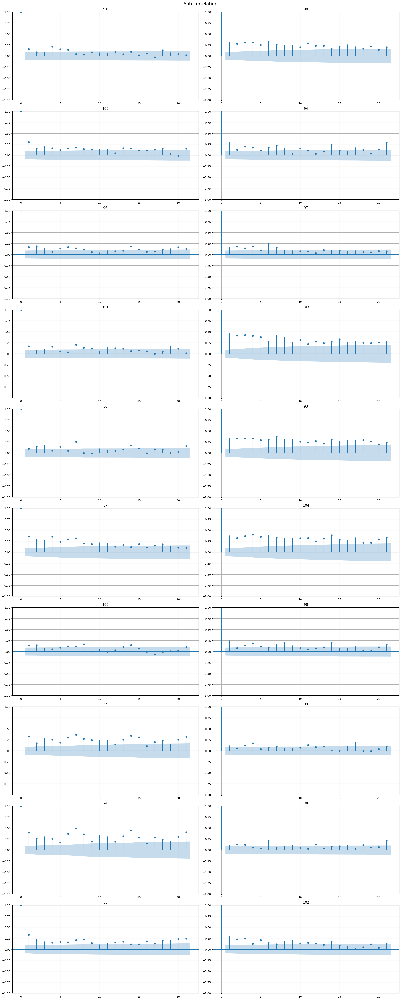

In [ ]:
acf_plot(ts, n_segments=ts.size()[1])

In [ ]:
# исходя из графика, отметим некоторые лаги
useful_lags = [1, 6, 7, 14, 21]

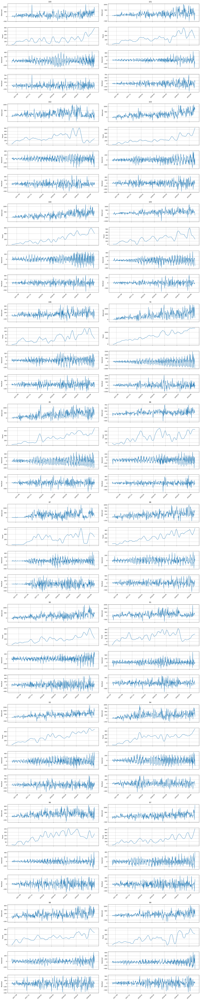

In [ ]:
stl_plot(ts, period=14)

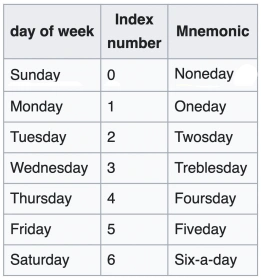